In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
pd.set_option("display.max_rows",20000)
pd.set_option("display.max_columns", 200)

# Loading the dataset 

In [2]:
# loading the dataset 
df = pd.read_excel(r"C:\Users\hp\Downloads\Call_Volume_Trend_Analysis_Project_9.xlsx")
df.head()

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
0,Executives 42,1000042.0,98502XXXXX,2,2022-01-01 09:02:38,9,9_10,00:01:36,96,answered,Agent,YES,00:00:16
1,Executives 4,1000004.0,80595XXXXX,0,2022-01-01 09:02:40,9,9_10,00:02:20,140,answered,Agent,YES,00:00:26
2,Executives 65,1000065.0,70202XXXXX,0,2022-01-01 09:02:49,9,9_10,00:01:25,85,answered,AutoWrapped,YES,00:00:16
3,Executives 55,1000055.0,96104XXXXX,1,2022-01-01 09:02:51,9,9_10,00:01:31,91,answered,Agent,YES,00:00:25
4,Executives 21,1000021.0,82001XXXXX,0,2022-01-01 09:02:55,9,9_10,00:02:45,165,answered,Agent,YES,00:00:23


In [3]:
# making a copy of it 
df_copy = df.copy()
df_copy.drop_duplicates(inplace = True)

# Exploring the dataset 

In [4]:
df_copy.columns

Index(['Agent_Name', 'Agent_ID', 'Customer_Phone_No', 'Queue_Time(Secs)',
       'Date_&_Time', 'Time', 'Time_Bucket', 'Duration(hh:mm:ss)',
       'Call_Seconds (s)', 'Call_Status', 'Wrapped _By', 'Ringing',
       'IVR _Duration'],
      dtype='object')

In [5]:
df_copy.shape

(117988, 13)

In [6]:
df_copy.size 

1533844

In [7]:
df_copy.describe()

,Agent_ID,Queue_Time(Secs),Date_&_Time,Time,Call_Seconds (s)
count,8.379000e+04,117988.000000,117988,117988.000000,117988.000000
mean,1.000034e+06,52.168051,2022-01-13 01:19:25.655702272,13.701792,139.532147
min,1.000001e+06,0.000000,2022-01-01 09:02:38,9.000000,0.000000
25%,1.000019e+06,8.000000,2022-01-07 12:16:48.249999872,11.000000,0.000000
50%,1.000034e+06,40.000000,2022-01-13 19:29:49,13.000000,115.000000
75%,1.000050e+06,103.000000,2022-01-17 15:11:05.500000,16.000000,202.250000
max,1.000065e+06,122.000000,2022-01-23 20:59:12,21.000000,3872.000000
std,1.820655e+01,46.154871,NaN,3.234274,158.512450


In [8]:
df_copy.isnull().sum()

Agent_Name            34198
Agent_ID              34198
Customer_Phone_No         0
Queue_Time(Secs)          0
Date_&_Time               0
Time                      0
Time_Bucket               0
Duration(hh:mm:ss)        0
Call_Seconds (s)          0
Call_Status               0
Wrapped _By           47877
Ringing                   0
IVR _Duration             0
dtype: int64

In [9]:
for i in list(df_copy.columns):
    print(f"column_name: {i}, len of unique = {len(df_copy[i].unique())}")
    print(df_copy[i].unique())

column_name: Agent_Name, len of unique = 66
['Executives 42' 'Executives 4' 'Executives 65' 'Executives 55'
 'Executives 21' nan 'Executives 49' 'Executives 50' 'Executives 59'
 'Executives 16' 'Executives 60' 'Executives 6' 'Executives 51'
 'Executives 40' 'Executives 54' 'Executives 41' 'Executives 15'
 'Executives 10' 'Executives 31' 'Executives 46' 'Executives 22'
 'Executives 26' 'Executives 53' 'Executives 23' 'Executives 47'
 'Executives 37' 'Executives 58' 'Executives 24' 'Executives 38'
 'Executives 18' 'Executives 48' 'Executives 9' 'Executives 30'
 'Executives 7' 'Executives 39' 'Executives 13' 'Executives 62'
 'Executives 19' 'Executives 35' 'Executives 25' 'Executives 29'
 'Executives 14' 'Executives 34' 'Executives 33' 'Executives 43'
 'Executives 1' 'Executives 27' 'Executives 12' 'Executives 28'
 'Executives 52' 'Executives 36' 'Executives 5' 'Executives 3'
 'Executives 17' 'Executives 63' 'Executives 8' 'Executives 61'
 'Executives 44' 'Executives 45' 'Executives 64' '

In [10]:
len(df_copy)

117988

In [11]:
df_copy.dtypes

Agent_Name                    object
Agent_ID                     float64
Customer_Phone_No             object
Queue_Time(Secs)               int64
Date_&_Time           datetime64[ns]
Time                           int64
Time_Bucket                   object
Duration(hh:mm:ss)            object
Call_Seconds (s)               int64
Call_Status                   object
Wrapped _By                   object
Ringing                       object
IVR _Duration                 object
dtype: object

In [12]:
for i in list(df_copy.columns):
    print(f"column name : {i}")
    print(df_copy[df_copy["Agent_Name"].isnull()][i].unique())

column name : Agent_Name
[nan]
column name : Agent_ID
[nan]
column name : Customer_Phone_No
['96424XXXXX' '96392XXXXX' '97232XXXXX' ... '63699XXXXX' '79865XXXXX'
 '98296XXXXX']
column name : Queue_Time(Secs)
[ 13  60 120  16  44  65   7  50  45  69  79  64  35  51   0  31  20  21
  56  53   4  11  58  87  26  85   3  72  43  70  95  49  94  42  89  22
 101  78 100  59  71  48  62  61  55 112  99 104  25  28  36  17  68  66
  75 116  73  90  52  54  77  15  80  40  92  67  32  24  14  46  57  81
  29  18  86  38  41  37  39   1 110  34  98 105 111   5  84 108  88   2
  63  76  83 113  23 106  10  27  30  33   8   6  47   9  12  91  96 102
 107  19 117 103 115  74  82  93 109  97 118 119 114]
column name : Date_&_Time
<DatetimeArray>
['2022-01-01 09:04:19', '2022-01-01 09:04:43', '2022-01-01 09:06:18',
 '2022-01-01 09:07:10', '2022-01-01 09:07:22', '2022-01-01 09:10:22',
 '2022-01-01 09:11:06', '2022-01-01 09:13:20', '2022-01-01 09:14:00',
 '2022-01-01 09:14:42',
 ...
 '2022-01-23 20:15:

In [13]:
df_copy[df_copy["Agent_Name"].isnull()]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
5,NaN,NaN,96424XXXXX,13,2022-01-01 09:04:19,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:16
7,NaN,NaN,96392XXXXX,60,2022-01-01 09:04:43,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:17
12,NaN,NaN,97232XXXXX,120,2022-01-01 09:06:18,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:40
15,NaN,NaN,77082XXXXX,16,2022-01-01 09:07:10,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:18
16,NaN,NaN,95255XXXXX,44,2022-01-01 09:07:22,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:17
...,...,...,...,...,...,...,...,...,...,...,...,...,...
117932,NaN,NaN,79813XXXXX,39,2022-01-23 20:35:26,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:19
117940,NaN,NaN,98296XXXXX,5,2022-01-23 20:40:31,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:22
117955,NaN,NaN,70745XXXXX,3,2022-01-23 20:46:18,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:42
117960,NaN,NaN,89292XXXXX,3,2022-01-23 20:48:32,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:19


# Handling the missing values 

In [14]:
for i in list(df_copy["Call_Status"].unique()):
    print(i)
    print(df_copy[df_copy["Call_Status"] == i]["Wrapped _By"].unique())

answered
['Agent' 'AutoWrapped' nan]
abandon
[nan]
transfer
['Agent' nan]


In [15]:
df_copy[df_copy["Agent_Name"].isnull()]["Wrapped _By"].unique()

array([nan], dtype=object)

In [16]:
df_copy[df_copy["Agent_Name"].isnull()]["Agent_ID"].unique()

array([nan])

In [17]:
df_copy[df_copy["Agent_ID"].isnull()]["Agent_Name"].unique()

array([nan], dtype=object)

In [18]:
df_copy[df_copy["Wrapped _By"].isnull()]["Agent_Name"].unique()

array([nan, 'Executives 42', 'Executives 65', 'Executives 50',
       'Executives 59', 'Executives 21', 'Executives 55', 'Executives 6',
       'Executives 16', 'Executives 4', 'Executives 51', 'Executives 40',
       'Executives 49', 'Executives 54', 'Executives 15', 'Executives 41',
       'Executives 31', 'Executives 22', 'Executives 26', 'Executives 23',
       'Executives 46', 'Executives 37', 'Executives 47', 'Executives 53',
       'Executives 60', 'Executives 24', 'Executives 58', 'Executives 48',
       'Executives 9', 'Executives 30', 'Executives 18', 'Executives 7',
       'Executives 38', 'Executives 39', 'Executives 10', 'Executives 19',
       'Executives 62', 'Executives 35', 'Executives 29', 'Executives 25',
       'Executives 13', 'Executives 14', 'Executives 34', 'Executives 33',
       'Executives 43', 'Executives 1', 'Executives 27', 'Executives 12',
       'Executives 28', 'Executives 52', 'Executives 36', 'Executives 3',
       'Executives 17', 'Executives 63', 'E

In [19]:
df_copy[df_copy["Wrapped _By"].isnull()]["Agent_ID"].unique()

array([     nan, 1000042., 1000065., 1000050., 1000059., 1000021.,
       1000055., 1000006., 1000016., 1000004., 1000051., 1000040.,
       1000049., 1000054., 1000015., 1000041., 1000031., 1000022.,
       1000026., 1000023., 1000046., 1000037., 1000047., 1000053.,
       1000060., 1000024., 1000058., 1000048., 1000009., 1000030.,
       1000018., 1000007., 1000038., 1000039., 1000010., 1000019.,
       1000062., 1000035., 1000029., 1000025., 1000013., 1000014.,
       1000034., 1000033., 1000043., 1000001., 1000027., 1000012.,
       1000028., 1000052., 1000036., 1000003., 1000017., 1000063.,
       1000005., 1000008., 1000061., 1000044., 1000045., 1000064.,
       1000057., 1000002., 1000011., 1000056., 1000020., 1000032.])

We can conclued from the above analysis that wherever we have null value in agent ID and agent name, the call was abandoned by the caller itself while he/she was waiting for the agent to pick it listening to IVR for curtain time 
So we can relpace the null values in the `Wrapped_By` column not having `Agent_Name` and `Agent_ID` with `Customer`, and `Agent_Name` and `Agent_ID` with `Not Mentioned` and `0.0`.

In [20]:
df_copy["Agent_Name"] = df_copy["Agent_Name"].fillna("Not Mentioned")
df_copy["Agent_ID"] = df_copy["Agent_ID"].fillna(0.)

In [21]:
df_copy.isnull().sum()

Agent_Name                0
Agent_ID                  0
Customer_Phone_No         0
Queue_Time(Secs)          0
Date_&_Time               0
Time                      0
Time_Bucket               0
Duration(hh:mm:ss)        0
Call_Seconds (s)          0
Call_Status               0
Wrapped _By           47877
Ringing                   0
IVR _Duration             0
dtype: int64

In [22]:
df_copy[df_copy["Agent_Name"] == "Not Mentioned"]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
5,Not Mentioned,0.0,96424XXXXX,13,2022-01-01 09:04:19,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:16
7,Not Mentioned,0.0,96392XXXXX,60,2022-01-01 09:04:43,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:17
12,Not Mentioned,0.0,97232XXXXX,120,2022-01-01 09:06:18,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:40
15,Not Mentioned,0.0,77082XXXXX,16,2022-01-01 09:07:10,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:18
16,Not Mentioned,0.0,95255XXXXX,44,2022-01-01 09:07:22,9,9_10,00:00:00,0,abandon,NaN,YES,00:00:17
...,...,...,...,...,...,...,...,...,...,...,...,...,...
117932,Not Mentioned,0.0,79813XXXXX,39,2022-01-23 20:35:26,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:19
117940,Not Mentioned,0.0,98296XXXXX,5,2022-01-23 20:40:31,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:22
117955,Not Mentioned,0.0,70745XXXXX,3,2022-01-23 20:46:18,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:42
117960,Not Mentioned,0.0,89292XXXXX,3,2022-01-23 20:48:32,20,20_21,00:00:00,0,abandon,NaN,YES,00:00:19


In [23]:
index = list(df_copy[df_copy["Agent_Name"] == "Not Mentioned"].index)
df_copy.loc[index,"Wrapped _By"] = "Customer"

In [24]:
df_copy.isnull().sum()

Agent_Name                0
Agent_ID                  0
Customer_Phone_No         0
Queue_Time(Secs)          0
Date_&_Time               0
Time                      0
Time_Bucket               0
Duration(hh:mm:ss)        0
Call_Seconds (s)          0
Call_Status               0
Wrapped _By           13679
Ringing                   0
IVR _Duration             0
dtype: int64

In [25]:
for i in list(df_copy["Call_Status"].unique()):
    print(i)
    print(df_copy[df_copy["Call_Status"] == i]["Wrapped _By"].unique())

answered
['Agent' 'AutoWrapped' nan]
abandon
['Customer' nan]
transfer
['Agent' nan]


In [26]:
df_copy[df_copy["Wrapped _By"].isnull()]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
20,Executives 42,1000042.0,79899XXXXX,52,2022-01-01 09:08:34,9,9_10,00:02:34,154,answered,NaN,YES,00:00:26
29,Executives 65,1000065.0,63523XXXXX,36,2022-01-01 09:11:21,9,9_10,00:01:27,87,answered,NaN,YES,00:00:17
37,Executives 50,1000050.0,97600XXXXX,20,2022-01-01 09:13:34,9,9_10,00:02:12,132,answered,NaN,YES,00:00:17
38,Executives 59,1000059.0,70510XXXXX,5,2022-01-01 09:13:38,9,9_10,00:01:58,118,answered,NaN,YES,00:00:16
39,Executives 21,1000021.0,72238XXXXX,5,2022-01-01 09:13:48,9,9_10,00:05:17,317,answered,NaN,YES,00:00:28
46,Executives 55,1000055.0,73557XXXXX,77,2022-01-01 09:15:27,9,9_10,00:02:59,179,answered,NaN,YES,00:00:21
62,Executives 21,1000021.0,87782XXXXX,2,2022-01-01 09:19:14,9,9_10,00:00:08,8,answered,NaN,YES,00:00:23
81,Executives 42,1000042.0,95255XXXXX,35,2022-01-01 09:24:32,9,9_10,00:02:37,157,answered,NaN,YES,00:00:26
83,Executives 55,1000055.0,96149XXXXX,59,2022-01-01 09:25:08,9,9_10,00:00:17,17,answered,NaN,YES,00:00:42
88,Executives 6,1000006.0,95739XXXXX,10,2022-01-01 09:26:10,9,9_10,00:05:06,306,answered,NaN,YES,00:00:41


In [27]:
df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "abandon")]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
5145,Executives 14,1000014.0,99097XXXXX,23,2022-01-02 10:29:36,10,10_11,00:00:00,0,abandon,NaN,YES,00:00:45
5908,Executives 60,1000060.0,81434XXXXX,120,2022-01-02 12:18:35,12,12_13,00:00:00,0,abandon,NaN,YES,00:00:00
6598,Executives 59,1000059.0,90359XXXXX,120,2022-01-02 14:27:19,14,14_15,00:00:00,0,abandon,NaN,YES,00:00:00
9373,Executives 31,1000031.0,91104XXXXX,120,2022-01-03 12:18:54,12,12_13,00:00:00,0,abandon,NaN,YES,00:00:00
9552,Executives 60,1000060.0,94905XXXXX,120,2022-01-03 12:41:11,12,12_13,00:00:00,0,abandon,NaN,YES,00:00:00
11762,Executives 51,1000051.0,83690XXXXX,2,2022-01-03 17:29:43,17,17_18,00:00:00,0,abandon,NaN,YES,00:00:00
14180,Executives 28,1000028.0,97903XXXXX,101,2022-01-04 12:01:57,12,12_13,00:00:00,0,abandon,NaN,YES,00:00:00
14225,Executives 16,1000016.0,94496XXXXX,120,2022-01-04 12:07:22,12,12_13,00:00:00,0,abandon,NaN,YES,00:00:00
15063,Executives 1,1000001.0,94913XXXXX,120,2022-01-04 13:34:43,13,13_14,00:00:00,0,abandon,NaN,YES,00:00:00
15109,Executives 48,1000048.0,90147XXXXX,76,2022-01-04 13:39:58,13,13_14,00:00:00,0,abandon,NaN,YES,00:00:00


In above senerio we are not sure who abandoned the call so, we will replace null values in `Wrapped _By` having `Agent_name` and `Agent_ID` and `Call_Status` is `abondon` with `Agent/Customer`

In [28]:
index = list(df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "abandon")].index)
df_copy.loc[index, "Wrapped _By"] = "Agent/Customer"

In [29]:
df_copy.isnull().sum()

Agent_Name                0
Agent_ID                  0
Customer_Phone_No         0
Queue_Time(Secs)          0
Date_&_Time               0
Time                      0
Time_Bucket               0
Duration(hh:mm:ss)        0
Call_Seconds (s)          0
Call_Status               0
Wrapped _By           13474
Ringing                   0
IVR _Duration             0
dtype: int64

In [30]:
df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "answered")]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
20,Executives 42,1000042.0,79899XXXXX,52,2022-01-01 09:08:34,9,9_10,00:02:34,154,answered,NaN,YES,00:00:26
29,Executives 65,1000065.0,63523XXXXX,36,2022-01-01 09:11:21,9,9_10,00:01:27,87,answered,NaN,YES,00:00:17
37,Executives 50,1000050.0,97600XXXXX,20,2022-01-01 09:13:34,9,9_10,00:02:12,132,answered,NaN,YES,00:00:17
38,Executives 59,1000059.0,70510XXXXX,5,2022-01-01 09:13:38,9,9_10,00:01:58,118,answered,NaN,YES,00:00:16
39,Executives 21,1000021.0,72238XXXXX,5,2022-01-01 09:13:48,9,9_10,00:05:17,317,answered,NaN,YES,00:00:28
46,Executives 55,1000055.0,73557XXXXX,77,2022-01-01 09:15:27,9,9_10,00:02:59,179,answered,NaN,YES,00:00:21
62,Executives 21,1000021.0,87782XXXXX,2,2022-01-01 09:19:14,9,9_10,00:00:08,8,answered,NaN,YES,00:00:23
81,Executives 42,1000042.0,95255XXXXX,35,2022-01-01 09:24:32,9,9_10,00:02:37,157,answered,NaN,YES,00:00:26
83,Executives 55,1000055.0,96149XXXXX,59,2022-01-01 09:25:08,9,9_10,00:00:17,17,answered,NaN,YES,00:00:42
88,Executives 6,1000006.0,95739XXXXX,10,2022-01-01 09:26:10,9,9_10,00:05:06,306,answered,NaN,YES,00:00:41


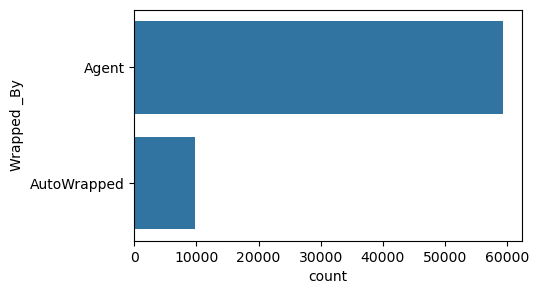

In [31]:
# Visulizing the Call_status column
figure = plt.figure(figsize = (5,3))
sns.countplot(df_copy[df_copy["Call_Status"] == "answered"]["Wrapped _By"])
plt.show()

We will replace the null value in the `Wrapped _By` column with `Agent` where the `Call_Status` is `"answered"`

In [32]:
index = list(df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "answered")].index)
df_copy.loc[index, "Wrapped _By"] = "Agent"

In [33]:
df_copy.isnull().sum()

Agent_Name              0
Agent_ID                0
Customer_Phone_No       0
Queue_Time(Secs)        0
Date_&_Time             0
Time                    0
Time_Bucket             0
Duration(hh:mm:ss)      0
Call_Seconds (s)        0
Call_Status             0
Wrapped _By           112
Ringing                 0
IVR _Duration           0
dtype: int64

In [34]:
df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "transfer")]

,Agent_Name,Agent_ID,Customer_Phone_No,Queue_Time(Secs),Date_&_Time,Time,Time_Bucket,Duration(hh:mm:ss),Call_Seconds (s),Call_Status,Wrapped _By,Ringing,IVR _Duration
2472,Executives 18,1000018.0,88853XXXXX,0,2022-01-01 14:30:59,14,14_15,00:02:27,147,transfer,NaN,YES,00:00:19
2540,Executives 7,1000007.0,79894XXXXX,0,2022-01-01 14:40:24,14,14_15,00:01:12,72,transfer,NaN,YES,00:00:42
2935,Executives 30,1000030.0,98486XXXXX,1,2022-01-01 15:40:54,15,15_16,00:00:55,55,transfer,NaN,YES,00:00:48
3311,Executives 42,1000042.0,96662XXXXX,0,2022-01-01 16:47:35,16,16_17,00:01:24,84,transfer,NaN,YES,00:00:18
3562,Executives 26,1000026.0,99511XXXXX,1,2022-01-01 17:30:23,17,17_18,00:01:32,92,transfer,NaN,YES,00:00:00
6981,Executives 42,1000042.0,94829XXXXX,1,2022-01-02 16:03:45,16,16_17,00:00:20,20,transfer,NaN,YES,00:00:15
7121,Executives 40,1000040.0,95502XXXXX,2,2022-01-02 16:36:05,16,16_17,00:00:58,58,transfer,NaN,YES,00:00:26
8593,Executives 54,1000054.0,86752XXXXX,105,2022-01-03 10:43:23,10,10_11,00:00:54,54,transfer,NaN,YES,00:00:18
9351,Executives 42,1000042.0,91104XXXXX,2,2022-01-03 12:16:29,12,12_13,00:00:25,25,transfer,NaN,YES,00:00:40
10576,Executives 42,1000042.0,90470XXXXX,0,2022-01-03 14:45:39,14,14_15,00:00:46,46,transfer,NaN,YES,00:00:41


In [35]:
df_copy.isnull().sum()

Agent_Name              0
Agent_ID                0
Customer_Phone_No       0
Queue_Time(Secs)        0
Date_&_Time             0
Time                    0
Time_Bucket             0
Duration(hh:mm:ss)      0
Call_Seconds (s)        0
Call_Status             0
Wrapped _By           112
Ringing                 0
IVR _Duration           0
dtype: int64

In [36]:
index = list(df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "transfer")].index)
len(index)

112

In [37]:
index = list(df_copy[(df_copy["Wrapped _By"].isnull()) & (df_copy["Call_Status"] == "transfer")].index)
df_copy.loc[index, "Wrapped _By"] = "Agent"

In [38]:
df_copy.isnull().sum()

Agent_Name            0
Agent_ID              0
Customer_Phone_No     0
Queue_Time(Secs)      0
Date_&_Time           0
Time                  0
Time_Bucket           0
Duration(hh:mm:ss)    0
Call_Seconds (s)      0
Call_Status           0
Wrapped _By           0
Ringing               0
IVR _Duration         0
dtype: int64

# Looking for errors 


In [39]:
# looking for errors if present in each column

In [40]:
df_copy.columns

Index(['Agent_Name', 'Agent_ID', 'Customer_Phone_No', 'Queue_Time(Secs)',
       'Date_&_Time', 'Time', 'Time_Bucket', 'Duration(hh:mm:ss)',
       'Call_Seconds (s)', 'Call_Status', 'Wrapped _By', 'Ringing',
       'IVR _Duration'],
      dtype='object')

In [41]:
df_copy.Agent_Name.value_counts()

Agent_Name
Not Mentioned    34198
Executives 59     2403
Executives 53     2325
Executives 23     2317
Executives 26     2282
Executives 21     2240
Executives 7      2232
Executives 36     2159
Executives 33     2125
Executives 46     2095
Executives 65     2066
Executives 35     2055
Executives 51     2040
Executives 42     1939
Executives 48     1937
Executives 4      1896
Executives 9      1874
Executives 60     1849
Executives 27     1824
Executives 34     1812
Executives 29     1802
Executives 55     1781
Executives 62     1775
Executives 12     1711
Executives 28     1708
Executives 13     1695
Executives 41     1690
Executives 61     1666
Executives 52     1571
Executives 24     1561
Executives 1      1559
Executives 25     1519
Executives 19     1513
Executives 15     1507
Executives 16     1463
Executives 37     1384
Executives 58     1292
Executives 43     1277
Executives 49     1245
Executives 17     1226
Executives 39     1131
Executives 6      1124
Executives 30     1104


In [42]:
df_copy.Agent_ID.value_counts()

Agent_ID
0.0          34198
1000059.0     2403
1000053.0     2325
1000023.0     2317
1000026.0     2282
1000021.0     2240
1000007.0     2232
1000036.0     2159
1000033.0     2125
1000046.0     2095
1000065.0     2066
1000035.0     2055
1000051.0     2040
1000042.0     1939
1000048.0     1937
1000004.0     1896
1000009.0     1874
1000060.0     1849
1000027.0     1824
1000034.0     1812
1000029.0     1802
1000055.0     1781
1000062.0     1775
1000012.0     1711
1000028.0     1708
1000013.0     1695
1000041.0     1690
1000061.0     1666
1000052.0     1571
1000024.0     1561
1000001.0     1559
1000025.0     1519
1000019.0     1513
1000015.0     1507
1000016.0     1463
1000037.0     1384
1000058.0     1292
1000043.0     1277
1000049.0     1245
1000017.0     1226
1000039.0     1131
1000006.0     1124
1000030.0     1104
1000005.0     1051
1000047.0     1033
1000063.0     1018
1000010.0      996
1000018.0      917
1000022.0      778
1000054.0      687
1000040.0      642
1000038.0      636
100

In [ ]:
df_copy.Customer_Phone_No.value_counts()

In [ ]:
df_copy['Queue_Time(Secs)'].value_counts()

In [ ]:
df_copy['Date_&_Time'].value_counts()

In [ ]:
df_copy.Time.value_counts()

In [ ]:
df_copy.Time_Bucket.value_counts()

In [ ]:
df_copy['Duration(hh:mm:ss)'].value_counts()

In [ ]:
df_copy['Call_Seconds (s)'].value_counts()

In [ ]:
df_copy.Call_Status.value_counts()

In [ ]:
df_copy['Wrapped _By'].value_counts()

In [ ]:
df_copy.Ringing.value_counts()

In [ ]:
df_copy['IVR _Duration'].value_counts()

We can see that we have issue in the `Customer_Phone_No` where we have `xxxxx` value, we have first five values for the phone number as numerical and rest as encrypted, so it could be a chance that it was false record or there was no call lets see it 

In [ ]:
df_copy[df_copy["Customer_Phone_No"] == "XXXXX"]

lets Create 3 columns Date, Time and Day from the Date_&_Time column

In [ ]:
df_copy['Dates'] = pd.to_datetime(df_copy['Date_&_Time']).dt.date
df_copy['Time_stamp'] = pd.to_datetime(df_copy['Date_&_Time']).dt.time
df_copy.drop("Date_&_Time", axis = 1, inplace = True)

In [ ]:
df_copy.columns

In [ ]:
df_copy["Day"] = pd.to_datetime(df_copy['Dates']).dt.day_name()

In [ ]:
df_copy[df_copy["Customer_Phone_No"] == "XXXXX"]

So there is no evidence which shows that the call is fake or false record so we will not change it 

In [ ]:
pd.get_dummies(df_copy['Call_Status'], prefix = "Call_Status", prefix_sep = "_", dtype = 'int64')

In [ ]:
df_copy = df_copy.join(pd.get_dummies(df_copy['Call_Status'], prefix = "Call_Status", prefix_sep = "_", dtype = 'int64'))

In [ ]:
df_copy.drop("Call_Status", axis = 1, inplace = True)

In [ ]:
df_copy.columns

In [ ]:
df_copy["Recieved"] = ((df_copy['Call_Status_answered'] == 1) | (df_copy['Call_Status_transfer'] == 1)).astype(int)

In [ ]:
df_copy.columns

In [ ]:
df_copy.to_csv(r"C:\Users\hp\Desktop\trainity projects\inbounding.csv")